# Ontario grids

This notebook works out (+ plots) different areas of Southern Ontario according to the different grid patterns present in the roads. I just chose Ontario because it has a particularly noticeable/weird assortment of street grids, but you could plug in data for anywhere.

In [2]:
import momepy as mm
import geopandas as gpd
import pandas as pd
import osmnx as ox
import contextily as cx
import pyproj
import matplotlib.pyplot as plt
import matplotlib.patheffects as PathEffects
from shapely.ops import transform
from libpysal import weights
from tqdm import tqdm

## Read in data

The two data sources used are the outline of land in a Southern part of the Canadian province of Ontario (the bit tucked into the Great Lakes), and the main roads in this area. Both of these are taken from OpenStreetMap. If you really wanted to and had more time than I do today, you could query the Overpass API directly from Python but I just used the [QuickOSM plugin](QuickOSM) in QGIS and saved the results locally as GeoPackages.

In [4]:
roads = gpd.read_file('roads.gpkg', layer='roads2')

/Users/matthewlaw/miniconda3/envs/gds/lib/python3.8/site-packages/geopandas/geodataframe.py:600: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


In [5]:
land = gpd.read_file('s_ontario_land.gpkg', layer='s_ontario_land')

/Users/matthewlaw/miniconda3/envs/gds/lib/python3.8/site-packages/geopandas/geodataframe.py:600: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


## Create enclosures

This divides the area up into polygons bounded by the roads and edge of the land.

In [6]:
enclosures = mm.enclosures(roads, limit=land)

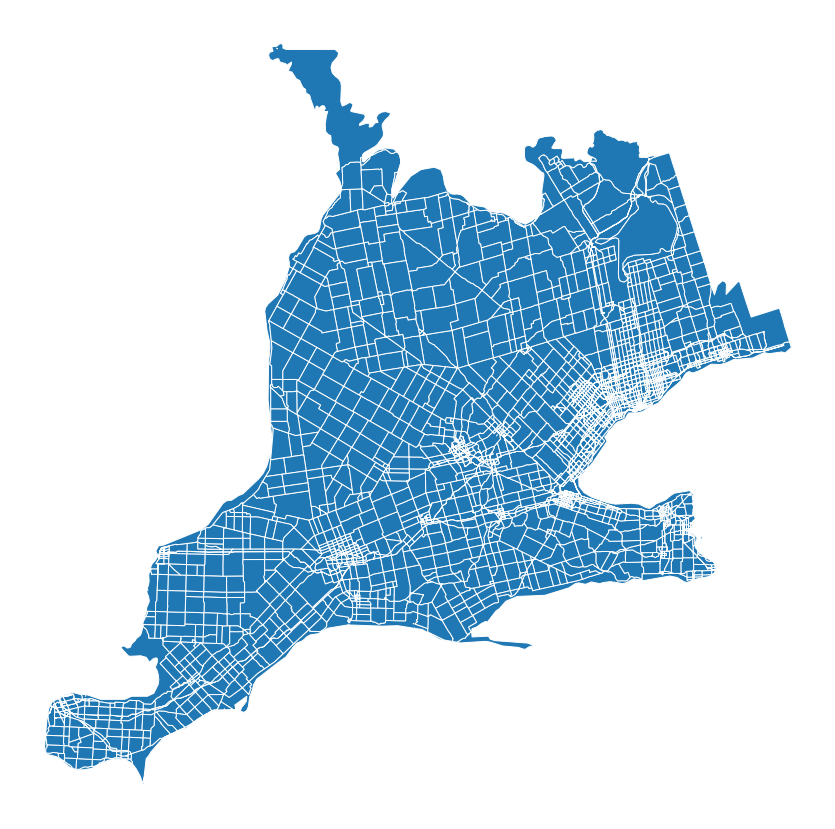

In [7]:
enclosures.plot(figsize=(15, 15), edgecolor='w').set_axis_off()

You see what I mean about the different grids? The geographic mind boggles.

## Calculate orientation of each enclosure

In [8]:
enclosures['orientation'] = mm.Orientation(enclosures).series

  0%|          | 0/9312 [00:00<?, ?it/s]

Round orientations to the nearest 5°

In [9]:
def round5(x, base=5):
    return base * round(x/base)

enclosures['orientation_5'] = round5(enclosures['orientation'])

## Define neighbours

(If you want to understand a bit more what's going on here, I heartily recommend the [Spatial Weights chapter](https://geographicdata.science/book/notebooks/04_spatial_weights.html) in *Geographic Data Science with PySAL and the PyData Stack*, freely available online)

2nd order queen contiguity neighbour:

In [10]:
queen2 = mm.sw_high(k=2, gdf=enclosures, ids="eID")

Enclosures within 15 km:

In [11]:
within15km = weights.DistanceBand.from_dataframe(enclosures, threshold=15000, binary=True, ids='eID', silence_warnings=True)

## Get a new orientation for each enclosure based on a range of contextual information including (but not necessarily limited to) the modal orientation (as determined by `momepy` and rounded to the nearest 5°) amongst a) enclosures that border a given enclosure, b) enclosures that border enclosures that border a given enclosure, and c) enclosures that do not satisfy a) or b) but are located within 15 km of a given enclosure

In [12]:
# stop annoying SettingWithCopyWarning
pd.options.mode.chained_assignment = None

In [13]:
%%time

# list of enclosure IDs
eIDs = enclosures['eID'].unique().tolist()
# initialise empty column
enclosures['orientation_5_mode2within15km'] = ""

# loop through all the enclosures
for i in tqdm(range(len(enclosures))):
    # make a list of eIDs of enclosure and its 'neighbours'
    neighbours = [eIDs[i]] # enclosure itself
    neighbours += queen2.neighbors[eIDs[i]] # 2nd order neighbours
    neighbours += within15km.neighbors[eIDs[i]] # enclosures within 15 km
    # subset to only those enclosures
    subset = enclosures.loc[neighbours]
    # get the mode of orientation in those enclosures
    enclosures['orientation_5_mode2within15km'][i] = subset['orientation_5'].mode().iloc[0]

100%|██████████████████████████████████████████████████████████████████████████████| 9312/9312 [01:47<00:00, 86.31it/s]

CPU times: user 1min 40s, sys: 5.3 s, total: 1min 46s
Wall time: 1min 47s


## Map it!

Static map:

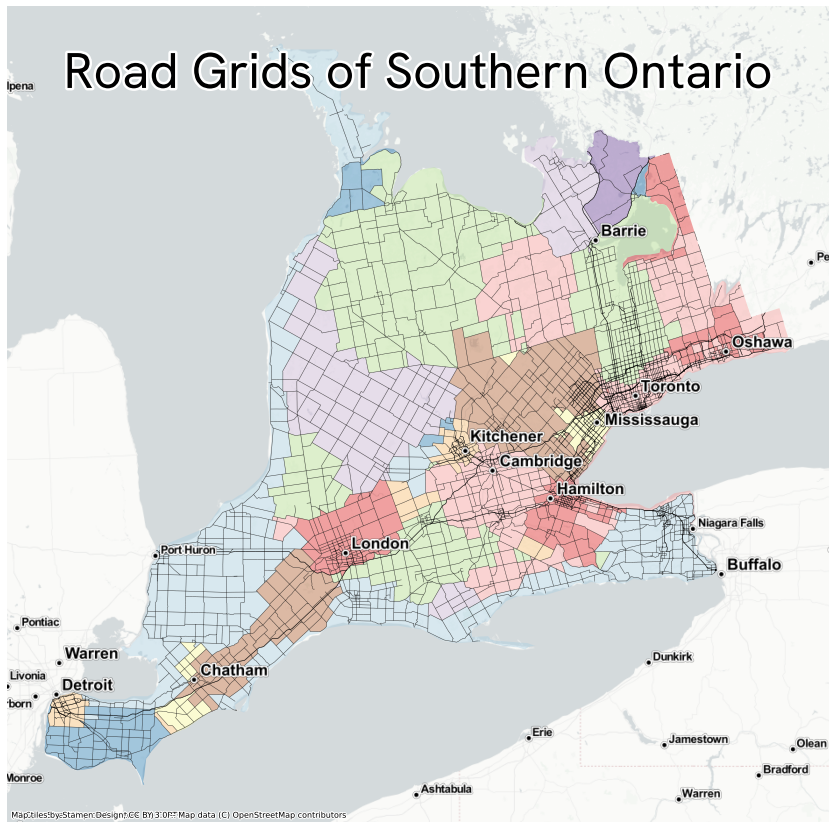

In [19]:
f, ax = plt.subplots(1, figsize=(15, 15))

enclosures.plot(ax=ax, column='orientation_5_mode2within15km', categorical=True, cmap="Paired", alpha=0.4)

roads.plot(ax=ax, color='black', linewidth=0.5, alpha=0.7)

cx.add_basemap(ax, crs=enclosures.crs, source=cx.providers.CartoDB.PositronNoLabels)

cx.add_basemap(ax, crs=enclosures.crs, source=cx.providers.Stamen.TonerLabels)

ax.text(.5,.9,'Road Grids of Southern Ontario',
        horizontalalignment='center',
        transform=ax.transAxes,
        size=50, **{'fontname':'HK Grotesk'}
       ).set_path_effects([PathEffects.withStroke(linewidth=5, foreground='w')])

ax.set_axis_off()

f.savefig('map', dpi=300, bbox_inches='tight', pad_inches = 0)

Very neat interactive version (courtesy of `geopandas.GeoDataFrame.explore`):

In [15]:
enclosures.explore(column='orientation_5_mode2within15km',
                   categorical=True,
                   cmap="Paired",
                   tiles="CartoDB positron")

Fun comparison: a figure from "The Land Surveys Of Ontario 1750–1980", an article by Louis M. Sebert in a 1980 edition of the journal *Cartographica* ([doi: 10.3138/X1G3-5822-25G2-027M](https://doi.org/10.3138/X1G3-5822-25G2-027M)) which gives a bit of insight into how the grids ended up this way

![image](https://i.imgur.com/VXxz7Er.png)